
# **Lenia: Exploring Artifical Life**

---

## **Abstract**

Since the 1940s, cellular automata have been investigated as models of discrete systems in fields ranging from biology to physics. Among the most well-known examples is Conway's Game of Life, which demonstrated how complex behaviors can emerge from minimal rules. Lenia has recently been developed as a generalisation of Game of Life, with continuous space, states and time replacing their discrete counterparts. In this notebook, the performance of multiple Lenia implementations are tested, including direct convolution and Fourier transformed convolution. The 'Orbium' is studied in detail and its stable range in parameter space is identified ($0.120≤m≤0.160$ and $0.0120≤s≤0.0160$). Asymptotic Lenia is examined and a new creature is found using a discovery tool. Finally, a proportionality relationship between $m$ and $s$ is identified for stable structures $s = (0.1085 ± 0.0044)m $. 

---

## **1. Introduction**
Cellular automata are mathematical models that simulate complex systems using simple rules applied to a grid of cells, where each cell updates its state based on the states of its neighbours. One of the most famous examples is Conway’s Game of Life (GoL), a two-dimensional cellular automaton where patterns emerge and evolve over time through basic birth, survival, and death rules<sup>[1]</sup>. Despite its simplicity, the Game of Life reveals rich dynamics. These include self-replication, chaos, and even universal computation, making it an integral model in artificial life and computer science. Lenia builds on this foundation by introducing continuous states, timesteps and growth functions (Table 1) that combine to create a more lifelike environment<sup>[2]</sup>. This then gives rise to organic behaviours and intricate pattern formation. The eventual goal of Lenia, and related models, is to assist in the creation of biological lifeforms through intelligent simulation and design.

| Component             | Conway's Game of Life                        | Lenia                                             |
|----------------------|----------------------------------------------|---------------------------------------------------|
| Grid Type            | 2D Grid                                      | 2D infinite grid (continuous space)      |
| Cell State           | Binary (0 or 1)                              | Continuous scalar (mass field)             |
| Time                 | Discrete time steps                          | Continuous-time approximation |
| Neighborhood         | Moore neighborhood (8 surrounding cells)     | Circular, normalised kernel  |                
| Update Mechanism     | Strict rules based on neighbor count        | Differential update using smooth growth function  |


**Table 1.** Comparison of key components of Conway's Game of Life and Lenia.

---

As of 2025, over 400 'creatures' have been identified and classified in the Lenia Taxonomy, with many more waiting to be discovered<sup>[3]</sup>. These creatures are defined by their starting grid formations and the parameters used to keep them stable for extended times. By examining the region of stability around known creatures we are able to set a bound on comb size that can be used to search through the unknown parameter space, with some confidence that interesting results are not being missed. Other emergent 'biological' phenomena are also observed, such as replication and locomotion, and these will be discussed in later sections of the report. While directly transferable insights cannot yet be made between biological and artificial life, theoretical models can shed light on fundamental principles such as symmetry and pattern formation.

## **2. Theoretical Background and Computational Analysis**


---

### 2.1 Mathematical Formulation

Lenia generalises Conway's Game of Life by operating on continuous state values, extracting a potential field using convolutional spatial interactions, and then applying a smooth non-linear growth function to this field. A rigid mathematical framework is required to facilitate this. 

We define the system over a discrete $N \times N$ grid.

---

#### **State Field**

Let the system state at time $t$ be:

$ A_t \in [0, 1]^{N \times N}$

where each element $A_t(x, y)$ represents the "mass" of the cell at $(x, y)$, taking continuous values in the closed interval $[0, 1]$.

---

#### **Kernel**

Let $K : \mathbb{Z}^2 \to \mathbb{R}_{\geq 0}$ be a convolution kernel that determines the spatial influence of neighbouring cells. 

 $ \sum_{i,j} K(i,j) = 1 $ to control energy density

---

#### **Potential Field**

The potential field $U_t$ is defined via discrete convolution:

$
U_t = K * A_t
$

---

#### **Growth Mapping**

The **growth function** $G : \mathbb{R} \to \mathbb{R}$ is a smooth, unimodal response function — typically a Gaussian that maps the local potential to a rate of change:

$
G(u) = 2 \times \exp\left( -\frac{(u - m)^2}{2s^2} \right) - 1
$

where:
- $m \in [0, 1]$ is the growth center 
- $s > 0$ controls the growth tolerance or spread

This function promotes growth near $u = m$, while suppressing it elsewhere. 

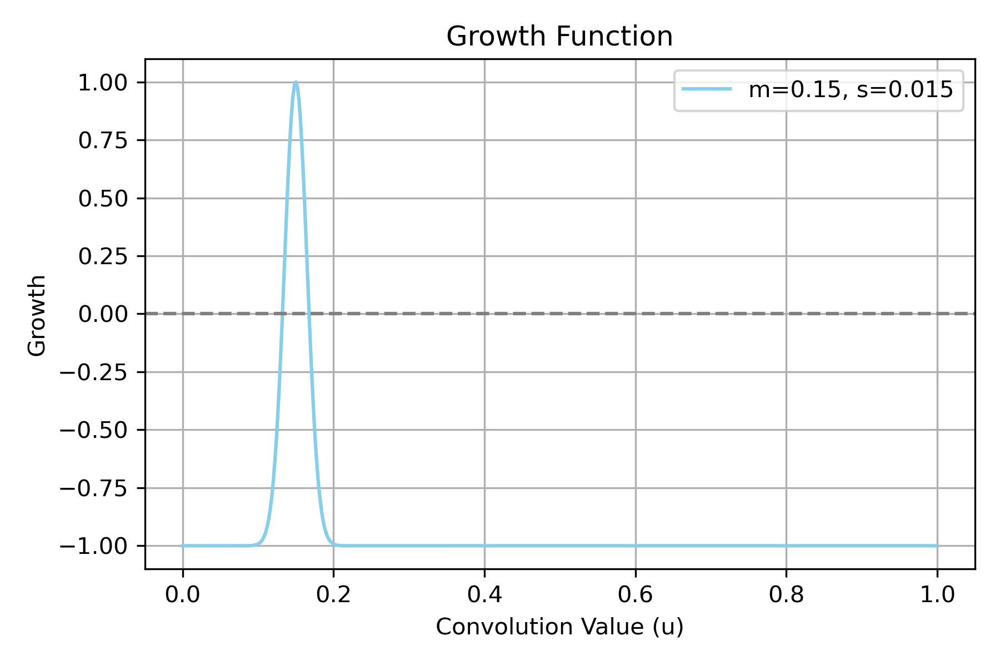

**Figure 1.** Growth function used for the Orbium creature.

---

#### **Update Rule**

Time advances in discrete steps $\Delta t > 0$, typically small (e.g. $0.1$). The standard Lenia update rule is:

$
A_{t+1} = \text{clip}(A_t + \Delta t \cdot G(U_t), 0, 1)
$

Here:
- $G(U_t)$ is applied element-wise
- The **clipping** ensures state values remain within $[0,1]$

---

### 2.2 Algorithmic Considerations

The primary algorithmic consideration is the method used to calculate the weighted number of neighbours for each cell. This is achieved in the basic GoL by individually adding up the values in the Moore Neighbourhood of each cell. Whilst this is sufficient for small kernel sizes, we will investigate alternate methods for use within Lenia.

#### 2.2.1 Convolution
#### 1. `np.fft` (Fast Fourier Transform)

- **Operation**: Transforms a signal from spatial domain to frequency domain.
- **Complexity**: 
  $
  O(N \log N)
  $
  for input of size $N$.
- **Usage in convolution**: 
  - Convolution in spatial domain can be replaced by pointwise multiplication in frequency domain.
  - Convolution via FFT is very fast for inputs that are a power of 2 due to symmetry. <sup>[4]</sup>

---

#### 2. `scipy.signal.convolve` (Spatial Convolution)

- **Operation**: Direct discrete convolution by sliding and summing.
- **Complexity**: 
  $O(Nk)$
  where $N$ is the number of elements in the grid and $k$ is the number of elements in the kernel.
- **Usage**:
  - For small kernels (e.g. $3 \times 3$), expect direct convolution is faster than FFT.
  
---

#### 3. `numpy.lib.stride_tricks.sliding_window_view` (Sliding Window)

- **Operation**: The window slides across all dimensions of the array and extracts subsets of the array at all window positions.
- **Complexity**:
  $O(Nk)$
  where $N$ is the number of elements in the grid and $k$ is the window size.
- **Usage**:
    - When no custom algorithm exists this function can be a good solution for small window sizes.<sup>[5]</sup>
  

#### 2.2.2 Boundary condition handling.
---

- In theory, Lenia is defined on an infinite discrete grid $\mathbb{Z}^2$. Every cell would interact with neighbors without artificial boundaries, providing perfect homogeneity. In simulations, we use a finite $N \times N$ grid to save memory and computing time (infinite time saving). This introduces artificial boundaries that must be handled carefully to minimise artifacts. Periodic boundary conditions will be used as they are easy to implement with `mode='wrap'` in convolution functions and conceptually match an infinite, repeating space.

---

| Method           | Description                                       | Comments                        |
|------------------|---------------------------------------------------|------------------------------|
| **Periodic**     | Wrap around edges (torus topology)                | Simulates infinite tiling |
| **Reflecting**   | Mirror values at the boundaries                   | Preserves local density |
| **Constant**     | Fill with a fixed value (e.g., 0 or 1)             | Can bias dynamics near edges |


**Table 2.** Common Boundary Conditions used in cellular automata and other grid based simulations.

---

## **3. Implementation and Performance**

### 3.1 Overview of Implementation

As Lenia was a system I had no initial understanding of, I started by writing a script for GoL (as recommended by Chan - creator of Lenia) and then modified the code until Lenia was reached<sup>[6]</sup>. This incremental approach means that I have many different Jupyter Notebooks and scripts, that are all slight improvements on the previous iteration, or test different things. As significant testing was carried out at each stage - as will be discussed later - these scripts have been retained in their original form and not compiled. The 'main.py' is my implementation of Lenia with a few options available for the user to choose.

The libraries used throughout the project are limited to NumPy, SciPy, Matplotlib and pygame, although pygame was only used in the initial stages to create an interactive version of GoL (available in the repository).

#### High-level structure of the code.
**1. Imports and Setup:** NumPy - calculations, SciPy - convolution, Matplotlib - animation.

**2. Grid:** The selected seed pattern is scaled and centered on a blank grid.

**3. Growth Function:** A growth function defines how the system updates each cell based on its neighborhood.

**4. Kernel:** A radial kernel is built to simulate interactions with neighbouring cells. The kernel is normalised so the total influence adds up to 1.

**5. Simulation:** Apply a convolution-based update to the grid over a set number of frames.

**6. Animation:** Use Matplotlib to animate the frames

### 3.2 Key Functions

**Update grid**

---

```python
def ugrid(grid, fK, T, m, s):
     '''grid - current state of all cells
        fK - Fourier Transformed Kernel
        T - 1/Δt
        m - centre of growth function
        s - width of growth function
        
        FFT convolution of grid and kernel, then inverse FT, return grid values clipped 
        between 0 and 1.'''       
    U = np.real(np.fft.ifft2(fK * np.fft.fft2(grid)))
    return np.clip(grid + (1 / T) * growth(U, m, s, T), 0, 1)
```

---

**Growth function**


```python
def gaussian(x, m, s):
    '''x - normalised sum of neighbour values
       m - mean
       s - width
        
       Returns value of Gaussian centered on m with width s'''
    return np.exp(-((x - m) / s) ** 2 / 2)

def growth(U, m, s, T):
    '''U - potential field, defined through discrete convolution
       m - centre of growth function
       s - width of growth function
       T - 1/Δt
       
       Growth function defined as 2*gaussian - 1 to give positive and negative values, 
       leading to growth and decay'''
    
    return gaussian(U, m, s) * 2 - 1
```

---

**Kernel**

```python
def build_k(R):
    '''
    R - Radius of Kernel
    
    2-D grid covering -R to R-1. Compute distance of each cell from the centre and normalise. 
    Define kernel as region (circle) with normalised distance < 1, multiplied by Gaussian.
    Normalise kernel.
    '''
    Y, X = np.ogrid[-R:R, -R:R]
    D = np.sqrt(X**2 + Y**2) / R
    K = (D < 1) * gaussian(D, 0.5, 0.15)
    K /= np.sum(K)
    return K

def pad_kernel(K, GS):
    '''
    K - Original Kernel
    GS - Grid Size

    Initialise empty GSxGS array of zeros. Take shape of input kernel.
    Insert kernel in top left corner of array. 
    Shift kernel to align with origin in frequency domain
    Take FFT.
    '''
    K_pad = np.zeros((GS, GS))
    K_shape = K.shape
    K_pad[:K_shape[0], :K_shape[1]] = K
    K_pad = np.roll(K_pad, -K_shape[0]//2, axis=0)
    K_pad = np.roll(K_pad, -K_shape[1]//2, axis=1)
    return np.fft.fft2(K_pad)

```

---

### 3.3 Performance

The performance of each method described in *Section 2.4.1* was tested first for a $3\times3$ kernel on a grid with variable size, and then for a variable kernel size on a $64\times64$ grid. The first test is most useful for the traditional GoL which only acts on the Moore Neighbourhood of each cell, whereas the second test applies more to Lenia. It is worth pointing out that in Figure 2.b the FFT method uses a kernel that is padded to the grid size for ease of calculation, hence no scaling with increasing kernel size as predicted. An implementation that pads the kernel to the nearest power of two would be most efficient but simplicity of code was prioritised.

All simulations were carried out on a Lenovo Yoga Slim 7i Pro X with 12th Gen Intel Core 12700H (20 Cores) at ~2.3GHz. We can see that in Figure 2.a, all four methods have similar scaling with grid size. Whereas Figure 2.b shows the advantage of using the FFT for convolution over performing convolution directly. These results confirmed our choice to use FFT in the update step and this method was used for the remainder of the project. The computational time of $100$ steps using FFT convolution on a $64 \times 64$ grid with $K=13$ was further analysed to provide a benchmark on this hardware. The value obtained was $Time = 0.028 ± 0.004$ s, which gives a time per step of $0.00028 ± 0.00004$ s.



a|b
-|-
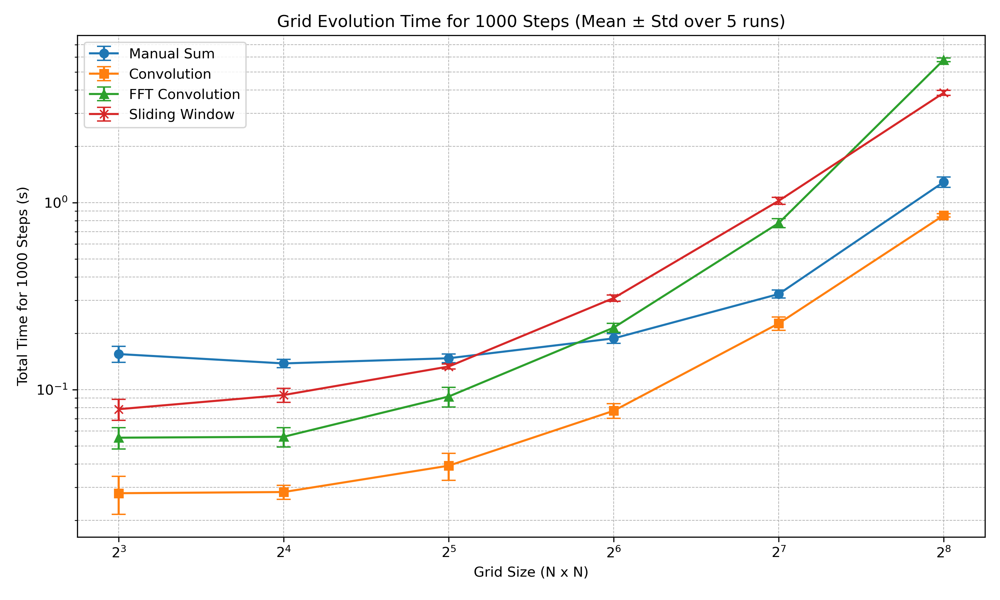|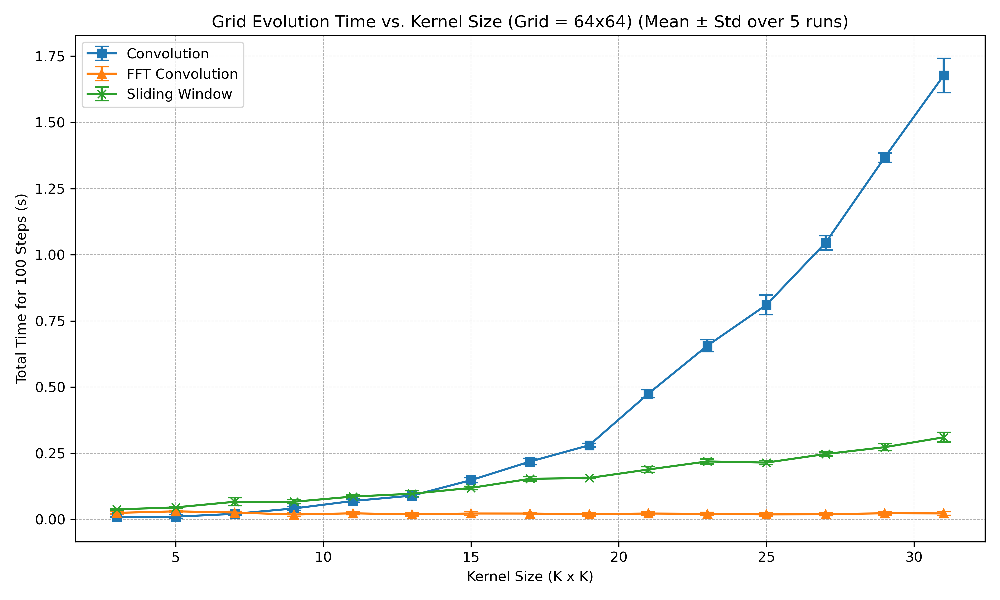


**Figure 2.**  **a)** Time taken for 1000 grid updates for four neighbourhood sum methods on a grid with variable size. **b)** Time taken for 100 grid updates for three neighbourhood sum methods on a 64x64 grid with variable kernel size. Note the FFT method used a kernel padded to the grid size in all cases, which explains the absence of scaling in b).

---

## **4. Results and Computational Physics Analysis**

a | b
- | - 
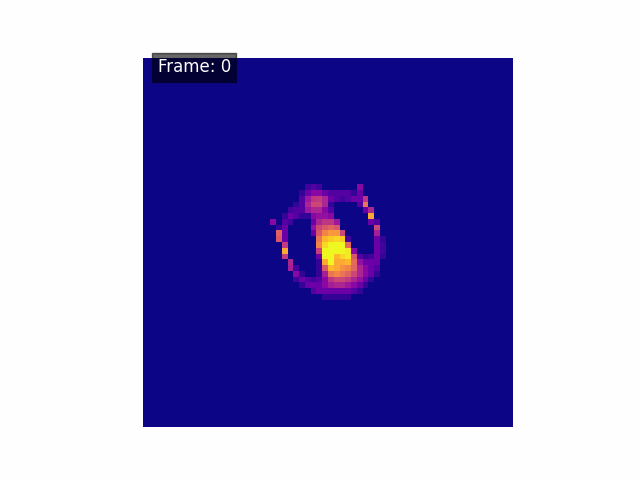 | 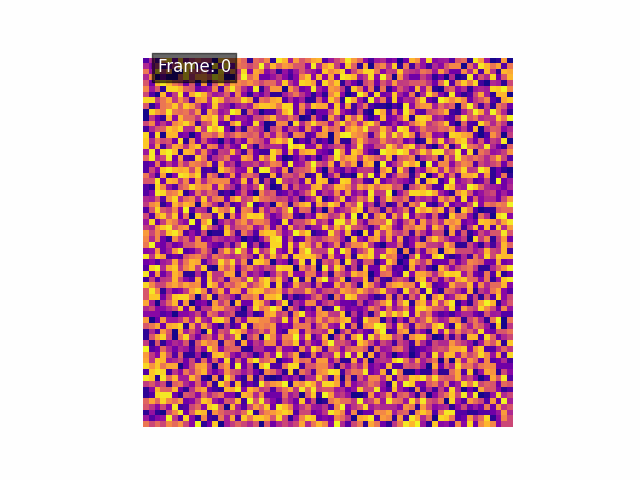

**Figure 3.** Simulations on the completed Lenia script using $m=0.15, s=0.015, T=10, R=13, N=64$ for the **a).** Orbium intitial configuration and **b).** random initial grid.





### 4.1 Behavior of Lenia Lifeforms

As the Lenia model consists of many parameters, it was important to isolate and identify the effect of each one. It would be computationally expensive to investigate all of the key parameters $R$, $T$, $m$, $s$ and initial grid $A_0$ simultaneously. A number of smaller tests were carried out to investigate these. The majority of the data analysis was conducted using standard NumPy and matplotlib packages in jupyter notebooks. Raw data for the bar charts, line graphs and contour plots are available in the 'Data' folder of the repository.


### 4.2 Stability Analysis

#### 4.2.1 Random Grid
In order to identify stable emergent structures, a sweep of suitable $m$ and $s$ values was conducted. The simulation was carried out for 100 time steps, using $R$ and $T$ values taken from the Orbium taxonomic entry. A contour plot (Figure 4a) was produced to visualise the regions of parameter space in which persistent spatial structures arose. Initial tests were performed across a broad grid of $m$ and $s$ values to ensure coverage of the full spectrum of possibilities, from chaotic dissolution to frozen order. Subsequent refinement focused on the region where intermediate complexity appeared to emerge, narrowing the range and increasing the resolution to reduce noise (Figure 4b). 

```python
def plot_contour(A, R, T, GS):
    """Contour plot that sweeps through m and s values, plots mean cell value after 
        100 iterations on the Z axis (colour)."""
    m_values = np.arange(0.14, 0.16, 0.001)
    s_values = np.arange(0.014, 0.016, 0.0001)
    M, S = np.meshgrid(m_values, s_values)
    Z = np.zeros_like(M)

    
    for i in range(len(m_values)):
        for j in range(len(s_values)):
            m = m_values[i]
            s = s_values[j]
            mean_value = generate_mean(A, R, T, m, s, GS)
            Z[j, i] = mean_value

    #Figure Settings. vmin/vmax sets the scale of the colours.
    plt.figure(figsize=(8, 6))
    cp = plt.contourf(M, S, Z, cmap='plasma') #, vmin=0, vmax=1)
    cbar = plt.colorbar(cp)
    cbar.set_label('Mean Grid Value')
    plt.title('Contour Plot of Mean Grid Value After 100 Iterations')
    plt.xlabel('m Value')
    plt.ylabel('s Value')
    plt.savefig('NewRandomContour.png', dpi=300)

    #Save data to npz file.
    np.savez('UltraFineOrbiumContour_data.npz', M=M, S=S, Z=Z)

    plt.show()

```
a|b
-|-
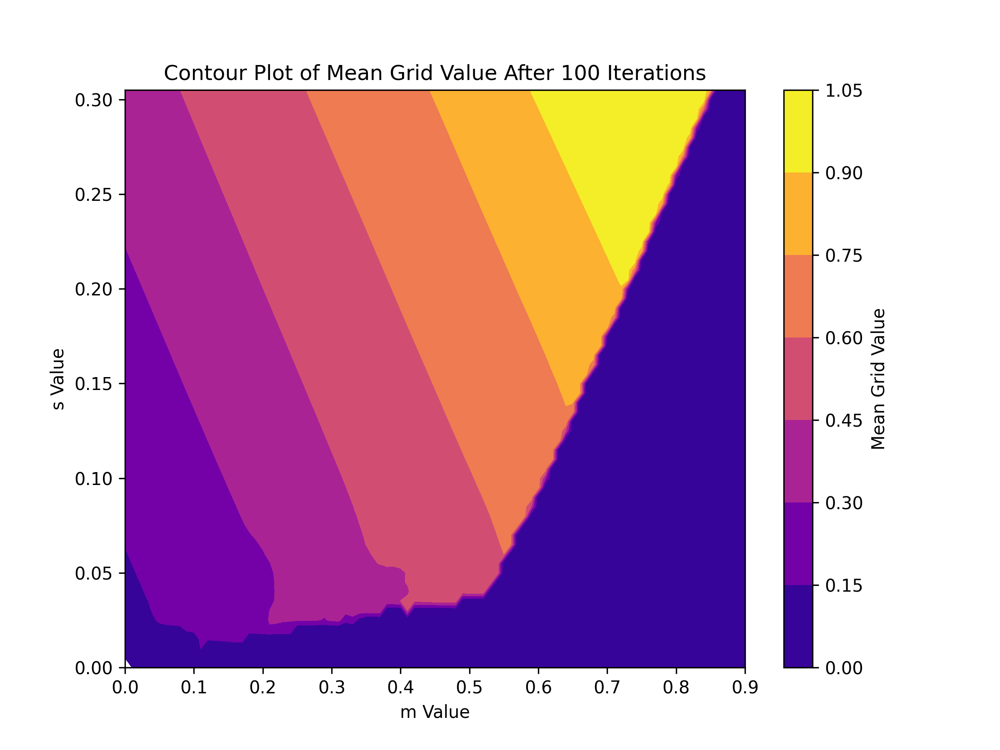|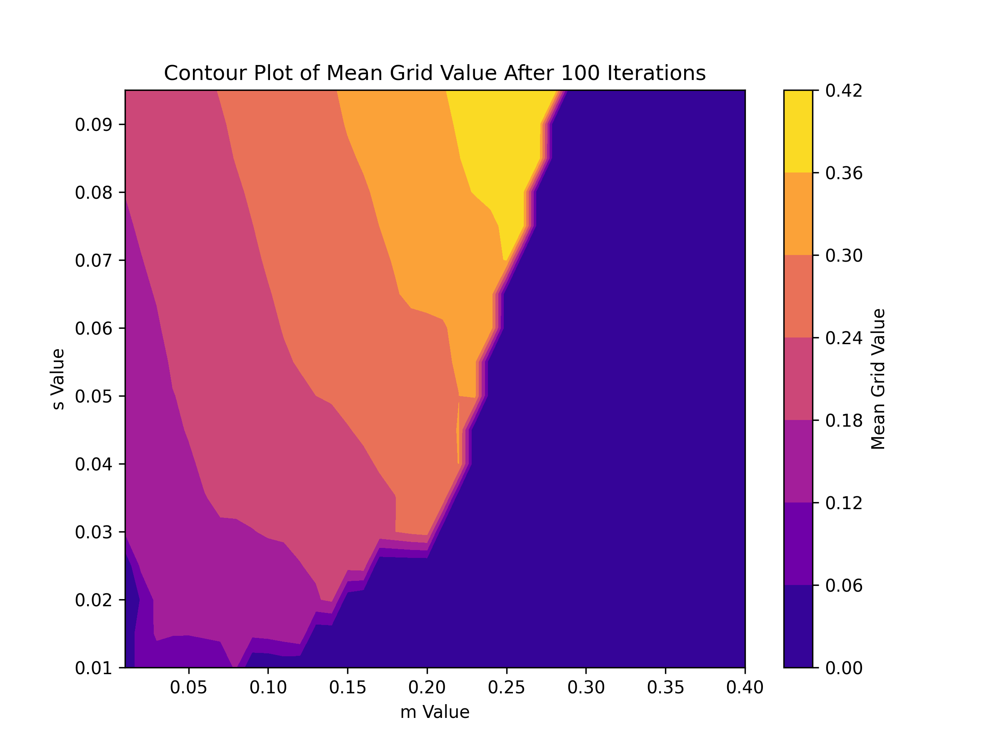

**Figure 4.** Contour plots of the $m - s$ parameter space for a random grid configuration. **a).** Broad sweep of the available range and **b).** Fine sweep of dynamic region closer to known creature parameters. Note different colour values between the two plots. In both plots the precision was one hundredth of the total range.

---

It is clear from both figures that increasing the width of the growth function $s$ for a given mean $m$ provides a stabilising effect. Cells whose values would otherwise fall outside the narrow region of optimal growth are now more likely to remain within the more forgiving range. The overall dynamics become more subdued, leading to a more stable configuration over time. From the tilt of the stripes in Figure 4a (close to vertical), it can be inferred that the mean value of the growth function has the greatest impact on the mean grid value. This result is not surprising, if growth is promoted in regions of high density, then we expect these to continue to grow. 
The systems also become more binary as the mean is increased. Volatile boundaries between empty and saturated grids are formed, presenting an interesting region for future study.
To investigate the details of the structure formation, coordinates from each section of the contour plot were taken and analysed further.

---


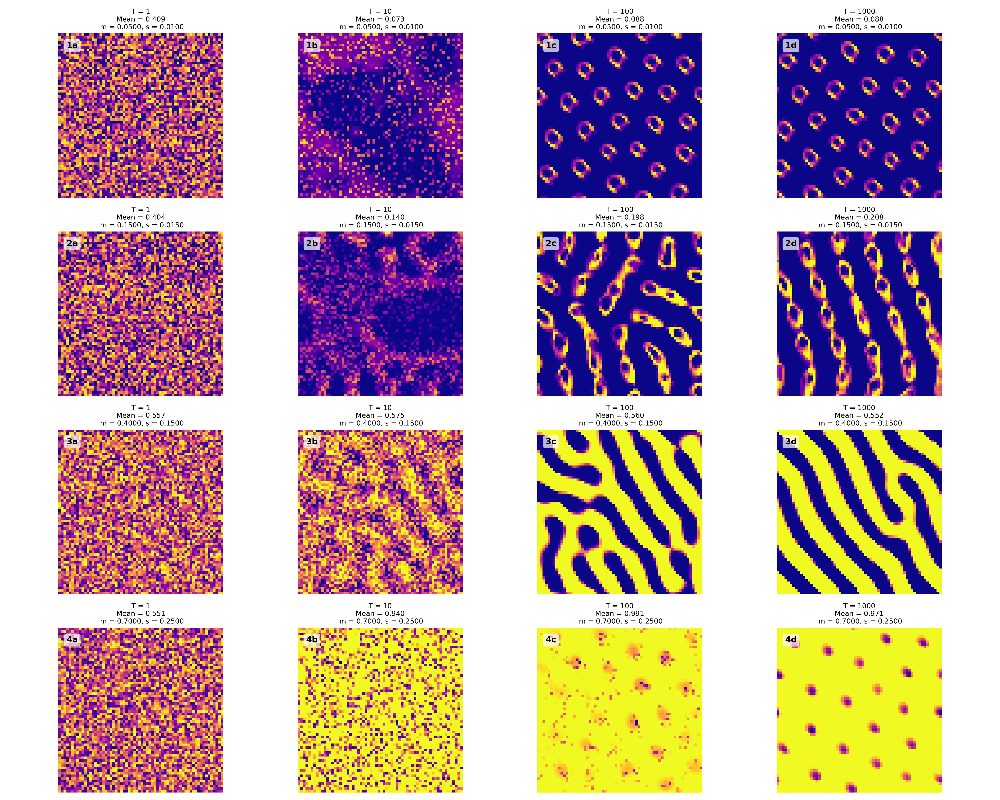
**Figure 5.** Evolution of four different $m-s$ parameter combinations for a random 64x64 grid initial configuration. **1).** $m=0.050, s=0.010$, **2).** $m=0.15, s=0.015$, **3).** $m=0.400, s=0.150$ and **4).** $m=0.700, s=0.250$

---

The morphology of each simulation, in all cases, appears to be determined by $T=100$. This justifies are previous assumption of testing for stability at the 100th time step. We see drastically different behaviour in the four cases. 
Figure 5.1 shows many small ring-like structures which are uniformally distributed and oriented. The mean cell value does not change between $T=100$ and $T=1000$, suggesting that these are highly stable.
Figure 5.2 exhibits more complex behaviour. Initially, 'figure of eight' or 'prokaryotic cell' structures are formed with no preferential orientation. Over time they rotate and align with eachother, forming a pattern that resembles a chain. This could be thought of as a phase transition, minimising potential energy by aligning the domains ('figure of eights'). In addition, the starting grid has a significant impact the development of these structures. In 3 out of the 10 tests the system collapsed and mean cell value reached zero after less than 100 timesteps. Further study with an external field is an exciting research prospect that could be used to shed insight on areas of statistical physics. 


Figure 5.3 shows a structure that is a remarkably similar to a Turing pattern, which were introduced by Alan Turing in "The Chemical Basis Of Morphogenesis" <sup>[7]</sup>. Turing's paper focusses on how stripes and spots can be formed in nature from initially uniform states. Whilst the underlying processes that form the pattern in our case are very different to Turing's, the principles are still the same. Starting from a homogeneous state, we convolve a smooth wide-spread kernel with the grid and pass it through a smooth growth function. This then results in complex stripes, spots and other patterns - another result that adds to the list of similarities Lenia shares with biological life. Figure 5.4 resembles 'Emmental cheese' (although this is partly due to colour choice). A solid background is uniformly dotted with small patches of a lower density. For longer times, $T=10000$, the patches remain the same size but decrease in mass (become darker blue), eventually becoming static.

---

#### 4.2.2 Orbium


a|b|c
-|-|-
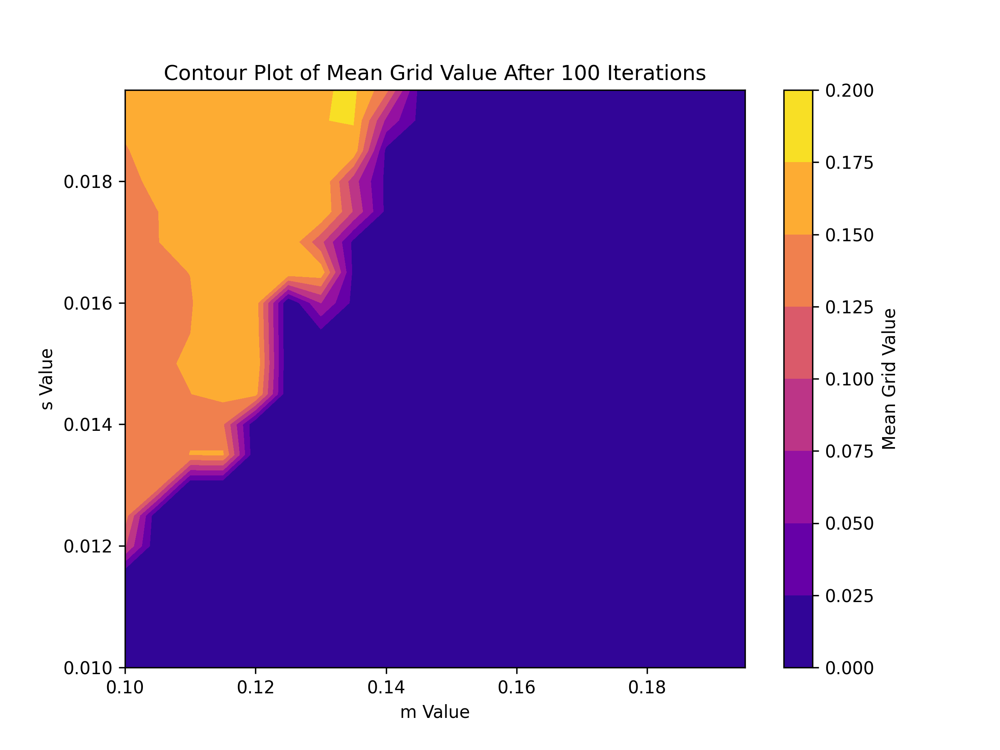|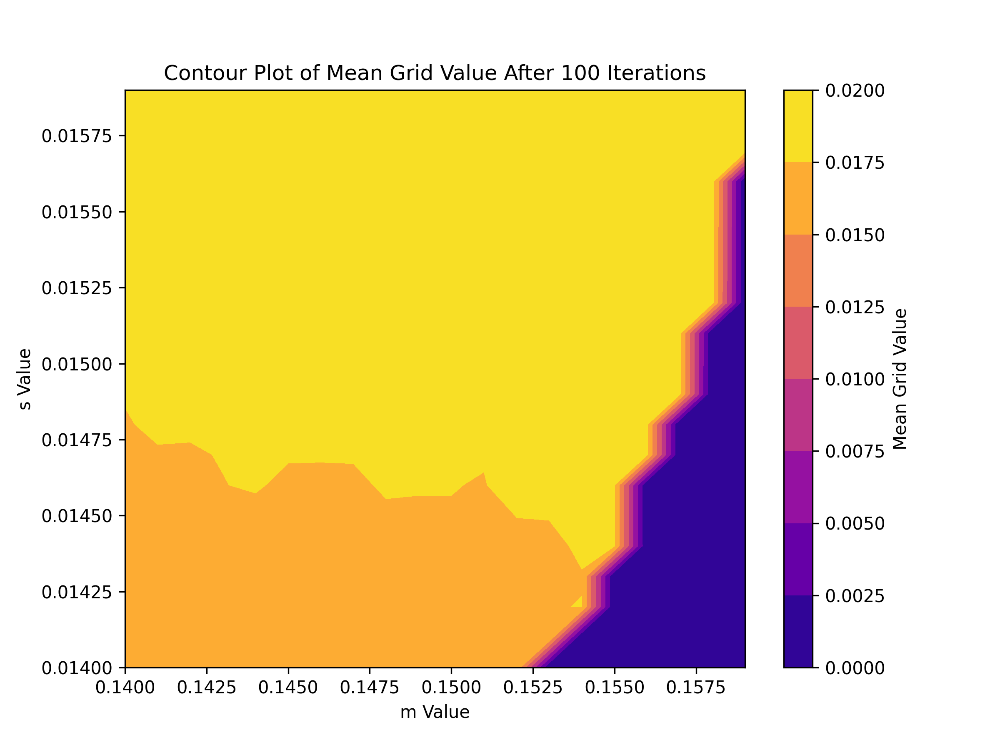 |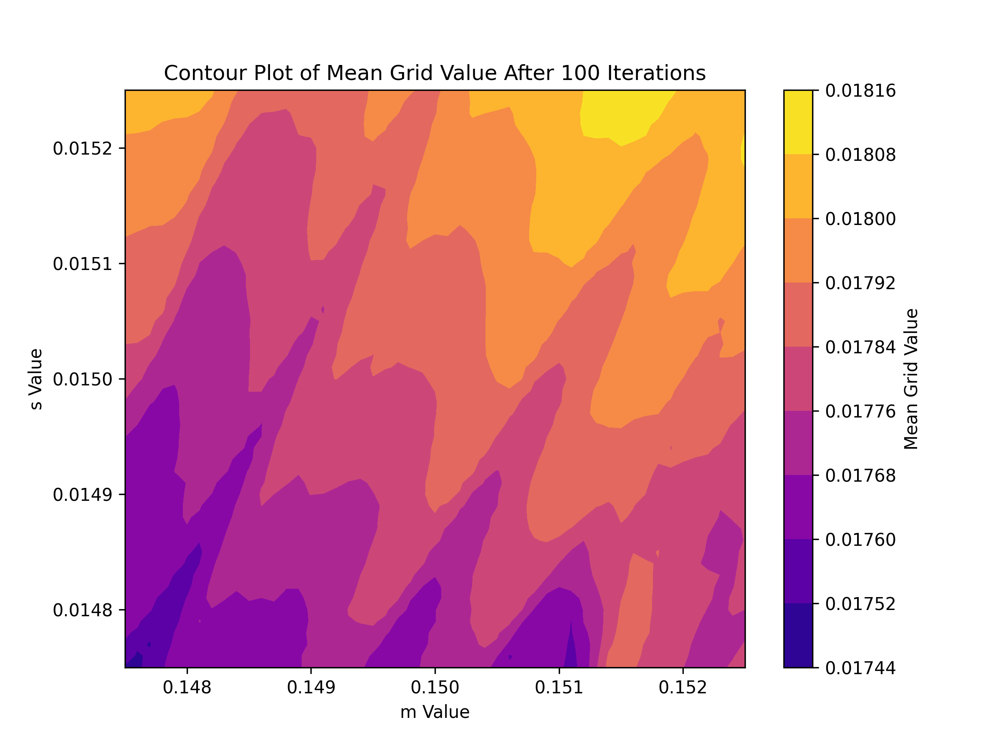

**Figure 6.** Stability contour plots for the Orbium initial configuration. **a).** Wide sweep of parameter space, **b).** Fine sweep and **c).** Ultra-fine sweep.

---

The process used in Section *4.2.1* was repeated, this time for the Orbium seed in an attempt to locate the stable parameter space of the creature. The initial sweep appeared to be too broad to distinguish any local change in detail. It did illuminate an area of interest where mean cell value had increased more significantly than others ($m =0.135$, $s=0.0195$). Two further plots were produced with finer resolutions and smaller areas. These were able to identify finer pattern structures in the parameter space as the range of Z values needed to cover reduced. The spike formation in Figure 6.c is striking. Increasing the resolution further retains this structure, suggesting that it is not an issue with noise and could be a feature of the parameter space. As before, some coordinate pairs were selected for further study - the animations are displayed below.

---

a|b|c
-|-|-
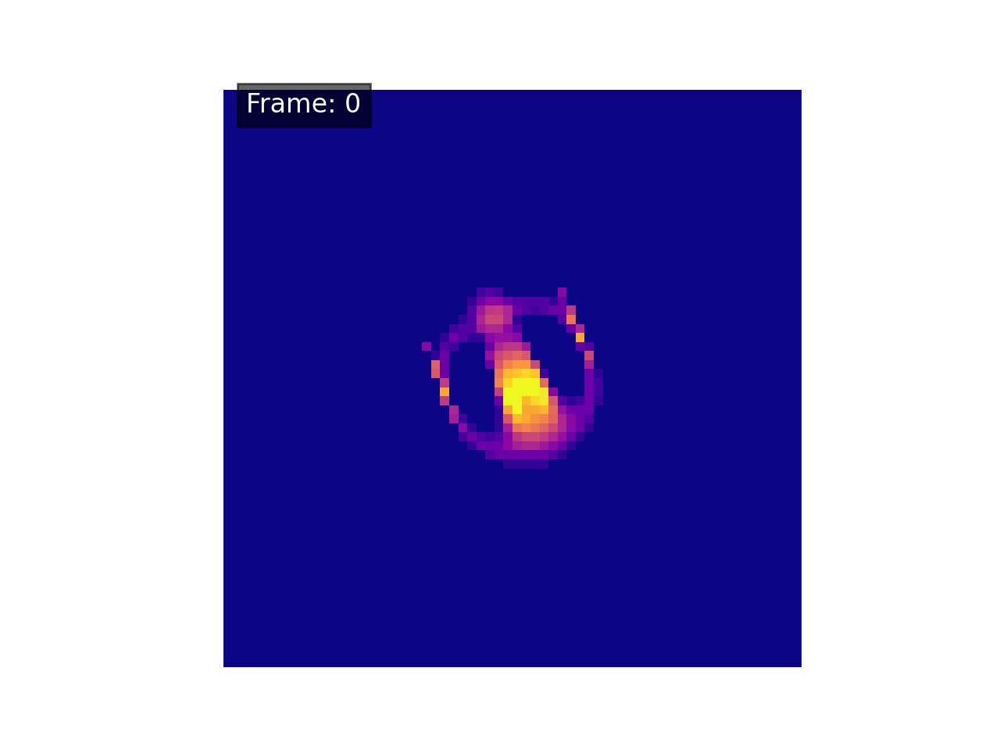|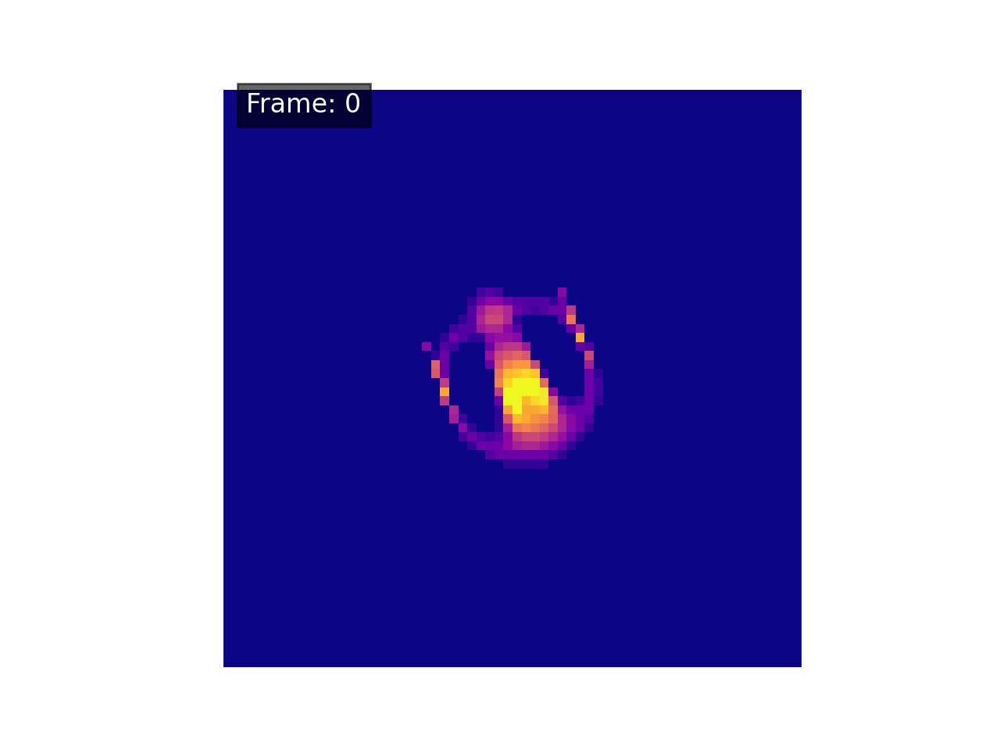|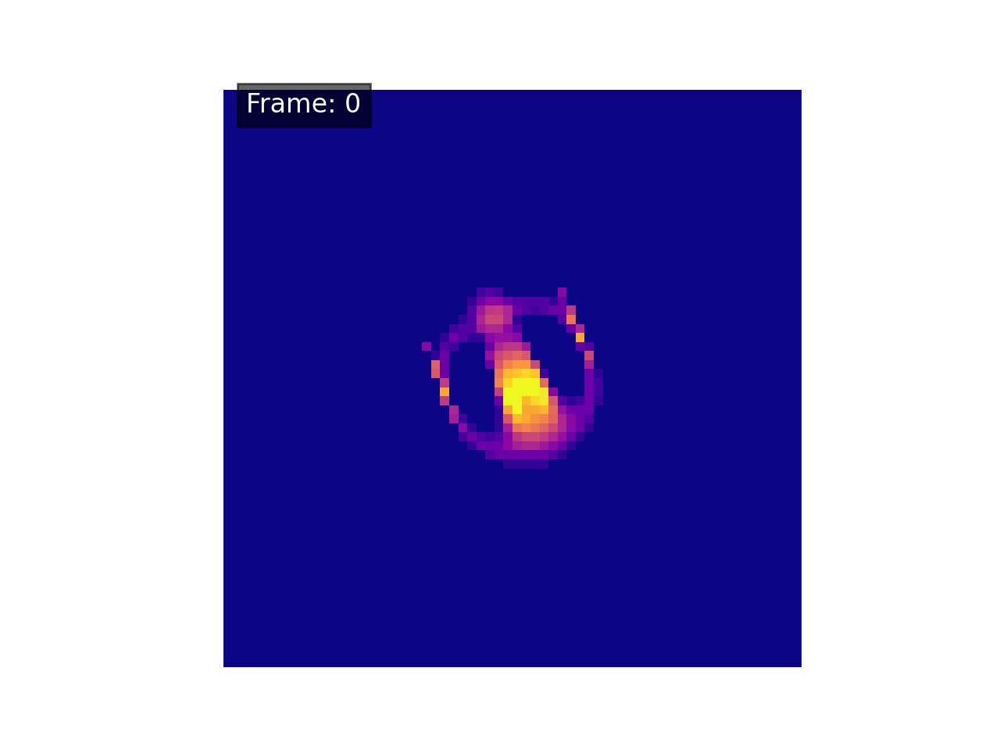


**Figure 7.** Animations of coordinates selected for further study. **a)** ($m =0.135$, $s=0.0195$) Orbium undergoes a meiotic-like event, **b)** ($m =0.16$, $s=0.0225$) Orbium becomes unstable and forms an oscillating structure and **c)** ($m =0.12$, $s=0.012$) the edge of stable Orbium parameter space.

---

In Figure 7.a we discover a process that resembles meiosis. In eukaryotic cells, meiosis is a form of cell division that forms four haploid sex cells or gametes. The Orbium comes to a stop, before splitting into 4 equal sub units. These are then surrounded by a membrane which further expands. The pattern tends to that in figure 5.2d, eventually indistinguishable from a random grid seed. Separation into four equal parts in a four-fold symmetric manner is unusual given the initial symmetry of the system is only two-fold.

In Conway's GoL, 'oscillators' are structures that return to their initial configuration after a finite time. Figure 7.b shows a rotating formation that arises from an orbium instability. This 'Circler' differs from many of those found in GoL as it retains a similar form as it turns back to its starting position. To my knowledge this creature has not been previously identified in literature, although this is difficult to verify.

Figure 7.c shows an Orbium that travels identically to the original Orbium, placing a lower bound on the deviation of parameters for stability. The values used were $m=0.120$ and $s=0.0120$ (original values $m=0.150$ and $s=0.0150$) and we can see that the morphology is relatively unchanged. Increasing both values simultaneously to $m=0.160$ and $s=0.0160$ saw the system collapse, demonstrating the asymmetry of the parameter space. Stable solutions were obtained up to $m=0.1595$ and $s=0.01595$. We would expect a more symmetric environment so it could be said that the exisiting literature values for 'Orbium' are incorrect and should be closer to $m=0.140$ and $s=0.0140$. This would give $\Delta m=0.02$ and $\Delta s=0.002$ either side. Placing a bound on monster stability helps to guide research into unknown parameter space to identify new monsters, as this can set the size of the comb, minimising unnecessary computational power and maximising space coverage.

---

### 5 Extending the model - Asymptotic Lenia
#### Theory

---

In 2021, Kawaguchi introduced an alternative formulation of Lenia - Asymptotic Lenia<sup>[8]</sup>. Replacing the core growth update with a target function that represents survivability better aligns with Conway's GoL. The resulting patterns become much smoother and no longer require clipping.
The update rule in Asymptotic Lenia is defined as:

$$
\mathbf{A}_{t + \Delta t} = \mathbf{A}_t + \Delta t \left( T(\mathbf{K} * \mathbf{A}_t) - \mathbf{A}_t \right) \tag{2}
$$

Where:

- $\mathbf{A}_t$ is the activity field at time $t$
- $\mathbf{K}$ is the convolution kernel
- **$T$** is the target function, replacing the growth function from Lenia
- $\Delta t$ is the timestep
- No clipping is applied — $A$ is allowed to move freely in $\mathbb{R}$

This can be written in differential form:

$$\frac{\partial \mathbf{A}}{\partial t} = T(\mathbf{K} * \mathbf{A}) - \mathbf{A} \tag{3}$$

We are now free to apply whichever numerical partial differential equation (PDE) solver we wish.

---




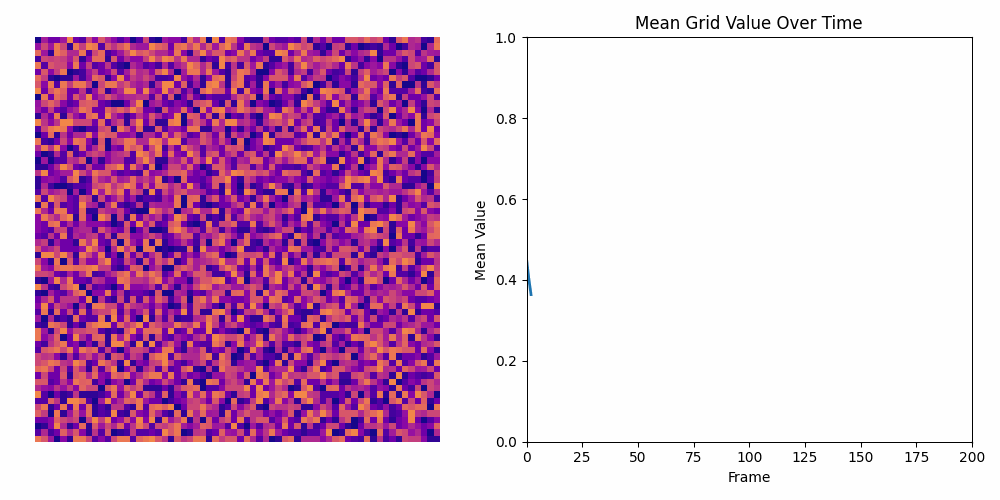
**Figure 8.** Asymptotic Lenia simulation beginning from a random grid configuration (left). Parameters used are $m=0.15, s=0.015, T=10, R=13,$ $ N=64$. The resulting patterns are much more fluid than standard Lenia whilst retaining a steady mean mass across generations (right).

---

In classical physics, the conservation of mass is considered a fundamental law. It is therefore important that our model of artificial life closely obeys this law if we want to draw meaningful comparisons with biological life. As can be seen in Figure 8 above, after an initial jump to an equilibrium mass, the system maintains an approximately constant value. Whilst this can also be observed in Lenia, it is not typically accompanied by rich dynamics - translation, expansion and contraction - when starting from a random grid. It is important to discuss the implications of switching to a teleological model. Natural environments form through processes which have no predefined goal. By setting a target function for the system to evolve towards we are breaking that natural progression. However, given that both formulations of Lenia are zero player games, the evolution is inherently deterministic regardless. Response to randomly perturbations introduced during simulations could provide an area for future studies.

The above animation was produced using the Euler method for solving a PDE. Before trialling the RK methods, it was expected that the Euler method would be faster than RK2 and RK4, but be less consistent due to the simpler update step. All three methods were tested using 50 random grids, 200 time steps and the same target function. The width of the target function was chosen to be on the edge of the stable region $s=0.006$ as it was thought that this steepness would give rise to varied evolutions. The mean execution time and mean cell value were plotted on separate bar charts below (Figure 9). The results clearly show that on average the Euler method is twice as fast as RK2 and almost four times as fast as RK4. Examining the final mean grid value shows an unexpected result: the Euler method has the smallest standard deviation after 50 runs. Reviewing the raw data, it was found that for both RK2 and RK4 the system decayed to zero mean value on one occasion. These were for different starting grids. I would postulate that on these occasions the initial grid is overanalysed, allowing unstable pattern formation. In a sense the more stochastic Euler method could benefit from its randomness by not allowing intabilities to grow.

---


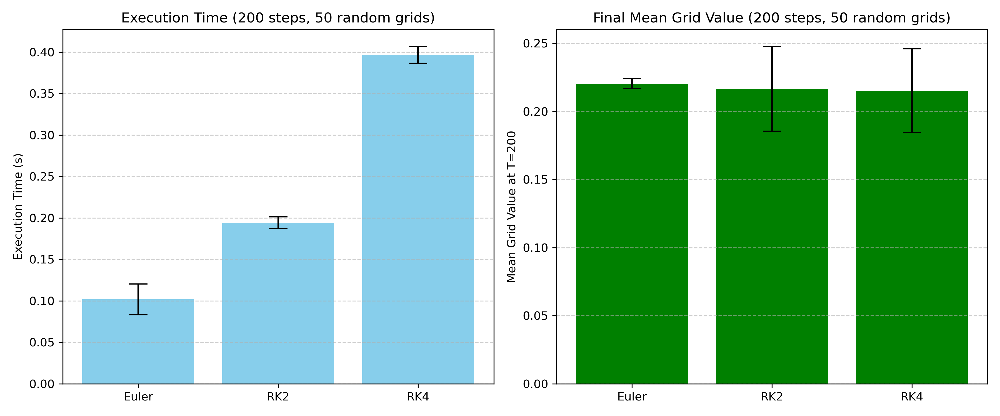
**Figure 9.** The mean execution time of 200 steps on a 64x64 grid for three PDE solvers across 50 runs (left). Corresponding mean mass across 50 runs on the same set-up (right)

---

### 5.2 Investigation

Through our investigation into Lenia and its stable parameter space, the target of identifying creatures within Asymptotic Lenia was set, using insights gained at earlier stages. It was clear from earlier investigation that a fully random grid seed either develops into a spatially uniform pattern or dies out. For this reason we used random $13\times13$ seeds, in the hopes of creating individual creatures. The $R=13$ and $T=10$ parameters were used from Orbium and the $m,s$ were chosen randomly from the intervals ($0.05≤m≤0.25$ and $0.005≤s≤0.025$) as these were found to be suitable for the Orbium seed from *4.2.2*. Stable seeds were identified by running each for 100 generations, which as found in section *4.2.1* is a good indicator for stability. Only grids with mean values between $0.01$ and $0.10$ were saved for future investigation, elimating full grid structures if they should emerge. Snapshots at $T=100$ were saved to a .npz file along with the parameters used. In total, $1000$ seeds were run, of which $29$ were saved by the program. 

```python
def discover_seeds():
    #User inputs m and s range
    m_min = float(input("Enter minimum m (e.g., 0.12): "))
    m_max = float(input("Enter maximum m (e.g., 0.16): "))
    s_min = float(input("Enter minimum s (e.g., 0.012): "))
    s_max = float(input("Enter maximum s (e.g., 0.016): "))

    #empty array to save good seeds
    accepted_data = []

    for seed_num in range(NUM_SEEDS):
        grid = np.zeros((size, size))
        #create a subarray that is filled with random numbers 0-1
        patch = np.random.rand(GS, GS)
        #find centre
        x0 = (size - GS) // 2
        #fill centre with subarray 'patch'
        grid[x0:x0+GS, x0:x0+GS] = patch
        init_grid = grid.copy()

        #select random m,s values from array.
        m = np.random.uniform(m_min, m_max)
        s = np.random.uniform(s_min, s_max)

        for _ in range(ITERATIONS):
            grid = update_grid(grid, m, s)

        mean_val = np.mean(grid)
        #write data if mean is in accepted range
        if MEAN_BOUNDS[0] <= mean_val <= MEAN_BOUNDS[1]:
            accepted_data.append({
                'init': init_grid,
                'final': grid,
                'm': m,
                's': s
            })
    #save file with name of user's choice.
    save_name = input("Enter filename to save (e.g. seeds.npz): ")
    np.savez(save_name, **{
        f"sample_{i}": accepted_data[i] for i in range(len(accepted_data))
    })
    print(f"Saved {len(accepted_data)} seeds to {save_name}")

    display_results(accepted_data)

```



---
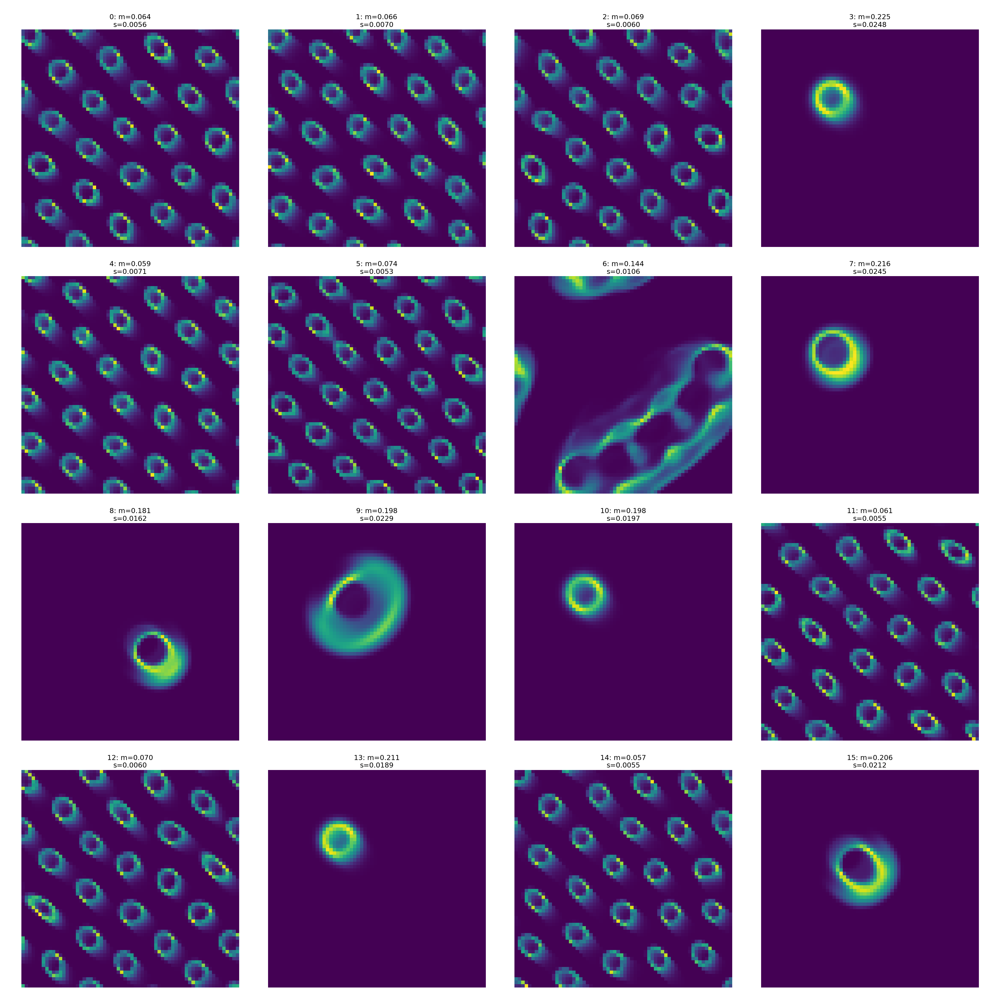

**Figure 10.** The first 16 out of 29 selected seeds after 100 generations. Full figure is available as seeds.png in Figures folder.

As can be seen in Figure 10, the majority of results consist of the pattern seen previously with many uniformly spaced rings. The next most common structure is a single larger circle. Animating selected seeds revealed that at some generation, all systems form a single ring-like structure. There are then three future evolutions. The ring begins to expand and then collapses as if by overinflation. Secondly, the ring undegoes a 'supernova' (e.g seed 9) and spreads rapidly to fill the entire grid. Or finally, and most interestingly, the ring remains stable for all future time (e.g seed 10)!

Whilst likely previously discovered, the rediscovery of a creature using this tool verifies its usefulness for future experiments. The parameters used for seed 10 are $R=13, T=10, m=0.198, s=0.0197$. Seed 10's data is available in the 'Data' folder. The relationship between $m$ and $s$ closely mirrors that of Orbium's, with the latter being around 10 times smaller than the former. A scatter plot was produced to investigate whether this was a fundamental feature of stable systems. Linear regression revealed the line of best fit with gradient $0.1085 ± 0.0044$ and y-intercept $-0.0014$, showing a relationship that is both directly proportional and statistically significant. The grouping of stable structures along a narrow strip in parameter space can greatly reduce the computation power necessary for investigation of related creatures.



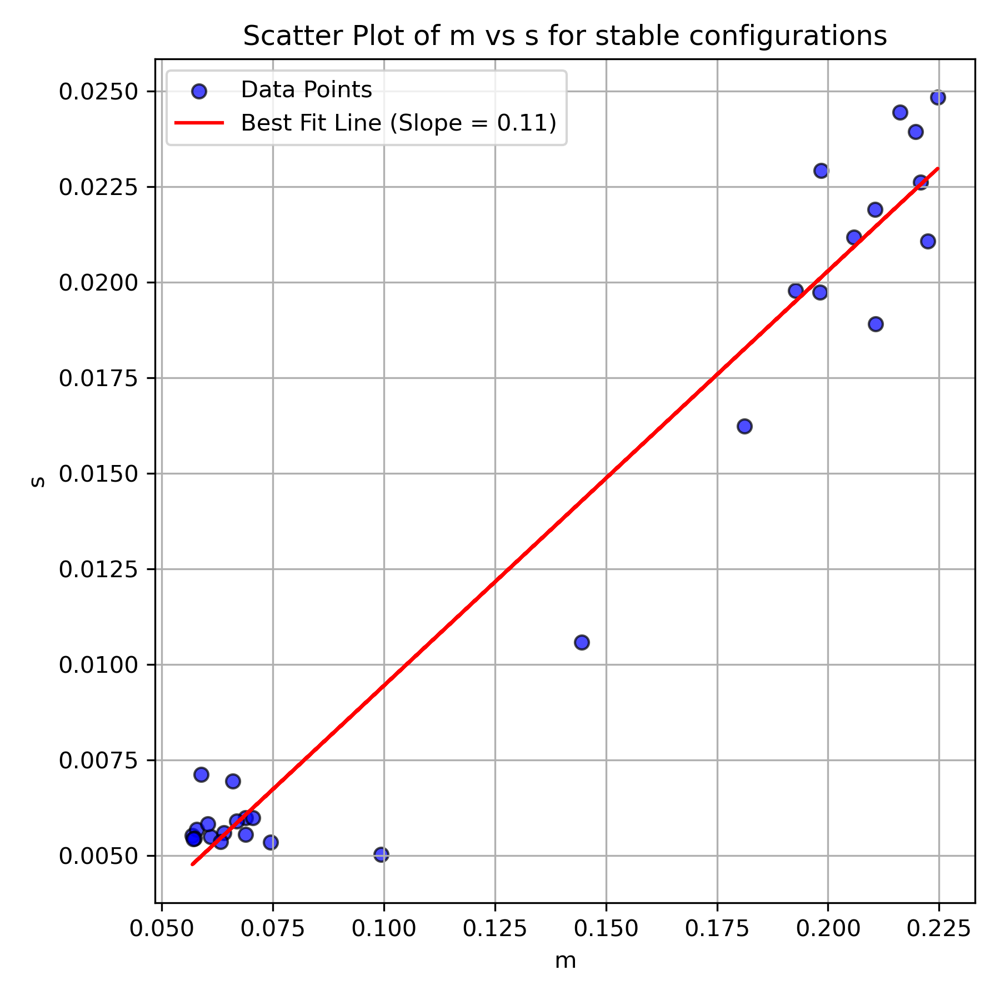

**Figure 11.** Scatter plot of $m-s$ values for 29 stable seeds found using discovery tool.

## **6. Conclusion**

In conclusion, this project on Lenia has explored the concept of autonomous, artificial life through the investigation of its stable parameter space, providing insight into the dynamic behaviors of Orbium and homogeneous random grids. 
By identifying key parameter ranges that lead to stable and reproducible patterns, we have advanced our understanding of how perturbations can significantly influence the system’s behavior, allowing researchers to utilise the most efficient search net when searching for new organisms. The stable range of Orbium was determined to be $1.20≤m≤1.60$ and $0.012≤s≤0.016$. The methodology is now in place to extend this to more creatures and identify patterns in their behaviour.

In addition, the exploration of parameter space revealed potential use cases within Computational Physics. Its generative properties can be utilised for novel research, with systems resembling ferromagnets and reaction-diffusion systems. The study of Asymptotic Lenia has provided an alternative approach for investigating these systems. It shows improved adherence to mass conservation and enhanced dynamics, but raises questions over protocol. We demonstrated that the Euler method provides not only the fastest update step but is also the most reproducible, reducing unnecessary execution time. Using results compiled from earlier in the notebook a  discovery tool is implemented that identifies a proportionality ratio - $s = (0.1085 ± 0.0044)m$ - as well as creature sourced from a random seed.
Overall, this project highlights the potential of Lenia not only as a tool for exploring artificial life but also as a valuable platform for further experimentation within physics and theoretical biology. 


---

## **References**


1. Article on John Conway's Game of Life (1970) https://web.stanford.edu/class/sts145/Library/life.pdf
2. Lenia  (2019) https://arxiv.org/pdf/1812.05433
3. Appendix for Lenia - Taxonomy. Chan (2019) https://wpmedia.wolfram.com/sites/13/2019/10/28-3-1-Appendix.pdf
4. Part II Computational Physics Lectures (2025) - Professor Lamacraft
5. NumPy documentation - Stride Tricks (2025) https://numpy.org/devdocs/reference/generated/numpy.lib.stride_tricks.sliding_window_view.html
6. From Conway to Lenia Jupyter Notebook. Chan (2025) https://colab.research.google.com/github/OpenLenia/Lenia-Tutorial/blob/main/Tutorial_From_Conway_to_Lenia.ipynb
7. The Chemical Basis of Morphogenesis - Turing (1952) https://www.dna.caltech.edu/courses/cs191/paperscs191/turing.pdf
8. Introducing asymptotics to the state-updating rule in Lenia. Kawaguchi (2021) https://www.researchgate.net/publication/353383915_Introducing_asymptotics_to_the_state-updating_rule_in_Lenia
